# Modelling

For this project, we will use the following models:
- DistilBERT to extract the features from the set of buy/sell sides of the order book

For the final layer, we will use the following models:
- A simple feedforward neural network to predict the price movement based on the previous prices + features from the previous step
- Convolutional Neural Network to predict the price movement based on the previous prices + features from the previous step
- Recurrent Neural Network to predict the price movement based on the previous prices + features from the previous step

### Prediction target:
- We will predict the next action (buy/sell)
- The price of this action
- The amount traded

In [1]:
! pip install datasets transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 536.7/536.7 kB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 13.6 MB/s eta 0:00:00


In [1]:
import os
import random

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import plotly.graph_objects as go

import torch
import torch.nn.functional as F

from tqdm import tqdm

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, mean_squared_error, mean_absolute_percentage_error
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split

from datasets import load_dataset, Dataset, DatasetDict

from transformers import AutoModel, AutoTokenizer, AutoModelForSequenceClassification, get_linear_schedule_with_warmup

from logger import get_logger
from utils import free_resources_deco

/home/stepan/.local/lib/python3.8/site-packages/pandas/core/computation/expressions.py:20: UserWarning: Pandas requires version '2.7.3' or newer of 'numexpr' (version '2.7.1' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED


In [2]:
# from google.colab import drive

# drive.mount('/content/gdrive')

In [3]:
SEED = 42

In [4]:
def seed_everything(seed=42):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True


seed_everything(seed=SEED)

In [5]:
def on_gpu(f):
    def wrapper(*args):
        if torch.cuda.is_available():
            return f(*args)
        else:
            print('cuda unavailable')

    return wrapper

In [6]:
if torch.cuda.is_available():
    ! pip install pynvml
    from pynvml import *
    from numba import cuda


@on_gpu
def print_gpu_utilization(dev_id):
    try:
        nvmlInit()
        handle = nvmlDeviceGetHandleByIndex(dev_id)
        info = nvmlDeviceGetMemoryInfo(handle)
        print(f"GPU memory occupied: {info.used // 1024 ** 2} MB.")
    except Exception as e:
        print(e)


@on_gpu
def free_gpu_cache(dev_id=0):
    print("Initial GPU Usage")
    print_gpu_utilization(dev_id)

    torch.cuda.empty_cache()

    print("GPU Usage after emptying the cache")
    print_gpu_utilization(dev_id)


def print_summary(result):
    print(f"Time: {result.metrics['train_runtime']:.2f}")
    print(f"Samples/second: {result.metrics['train_samples_per_second']:.2f}")
    print_gpu_utilization()

Defaulting to user installation because normal site-packages is not writeable


In [7]:
device = torch.device(f'cuda:1' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda', index=1)

In [8]:
if torch.cuda.is_available():
    torch.cuda.set_device(device)

In [9]:
MODEL_NAME = 'distilbert-base-cased' # xlnet/xlnet-base-cased
DATASET_NAME = 'crypto-trading'

NUM_LABELS = 2

NUM_EPOCHS = 1
BATCH_SIZE = 512
MAX_SEQ_LEN = 32
LEARNING_RATE = 2e-4
MAX_GRAD_NORM = 1000

In [10]:
cols_to_remove = ['exchange', 'symbol', 'start_timestamp', 'start_local_timestamp', 'price_target', 'amount_target', 'local_timestamp_target', 'timestamp_target'] + [f'side_{i}' for i in range(1, 17)] + [f'price_{i}' for i in range(1, 17)] + [f'amount_{i}' for i in range(1, 17)]

In [11]:
dataset = load_dataset('csv', data_files='data/final_processed.csv', cache_dir='data/cache').remove_columns(cols_to_remove)  # .shuffle(seed=SEED)
dataset

DatasetDict({
    train: Dataset({
        features: ['side_target', 'text', 'target', 'prices_amounts'],
        num_rows: 21927859
    })
})

In [12]:
# indices = [random.randint(1, len(dataset)) for _ in range(1_000_000)]
# ds = dataset['train'].select(indices)
# ds

In [13]:
# ds = DatasetDict(dataset['train'].train_test_split(0.2))
ds = dataset['train']
ds

Dataset({
    features: ['side_target', 'text', 'target', 'prices_amounts'],
    num_rows: 21927859
})

In [14]:
tokenizer = AutoTokenizer.from_pretrained(MODEL_NAME)
tokenizer

DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
}

In [15]:
# help(dataset.map)

In [16]:
def convert_array(prices, targets):
    res_prices = [None] * len(prices)
    res_targets = [None] * len(targets)
    for i, (tg, pr) in enumerate(zip(prices, targets)):
        res_prices[i] = eval(tg)
        res_targets[i] = eval(pr)
    return {'prices_amounts': res_prices, 'target': res_targets}

In [17]:
tokenized_dataset = ds

tokenized_dataset = tokenized_dataset.map(
    lambda x: convert_array(x['prices_amounts'], x['target']), 
    batched=True, 
    num_proc=24, 
    batch_size=1000, 
    load_from_cache_file=True,
)

tokenized_dataset = tokenized_dataset.map(
    lambda x: tokenizer(
        x['text'], 
        truncation=True, 
        padding='max_length', 
        max_length=MAX_SEQ_LEN,
        return_tensors='pt'
    ), 
    batched=True, 
    num_proc=24, 
    batch_size=1000, 
    load_from_cache_file=True,
).remove_columns(['text'])

tokenized_dataset.set_format('torch', device=device)
tokenized_dataset

Map (num_proc=24):   0%|          | 0/21927859 [00:00<?, ? examples/s]

Map (num_proc=24):   0%|          | 0/21927859 [00:00<?, ? examples/s]

Dataset({
    features: ['side_target', 'target', 'prices_amounts', 'input_ids', 'attention_mask'],
    num_rows: 21927859
})

In [21]:
test_dataset = tokenized_dataset.select([i for i in range(1, 50_000 + 1)])
test_dataset

Dataset({
    features: ['side_target', 'target', 'prices_amounts', 'input_ids', 'attention_mask'],
    num_rows: 50000
})

In [20]:
tokenized_dataset = DatasetDict(tokenized_dataset.train_test_split(0.2))
tokenized_dataset

DatasetDict({
    train: Dataset({
        features: ['side_target', 'target', 'prices_amounts', 'input_ids', 'attention_mask'],
        num_rows: 17542287
    })
    test: Dataset({
        features: ['side_target', 'target', 'prices_amounts', 'input_ids', 'attention_mask'],
        num_rows: 4385572
    })
})

In [22]:
def eval(f):
    def wrapper(model, *args, **kwargs):
        model.eval()
        return f(model, *args, **kwargs)

    return wrapper


def train(f):
    def wrapper(model, *args, **kwargs):
        model.train()
        return f(model, *args, **kwargs)

    return wrapper

In [23]:
def get_preds_from_logits(outputs):
    logits = outputs.logits
    probs = F.softmax(logits, dim=-1).unsqueeze(0)
    pred = torch.argmax(probs, dim=-1).cpu()  # (B)
    return outputs.loss, pred, logits


def get_multioutput_preds_from_logits(outputs, thresh=0.5):
    logits = outputs.logits
    pred = torch.stack([(F.sigmoid(logits[:, 0]) > thresh).long(), logits[:, 1], logits[:, 2]], dim=1).cpu()  # (B, 3)
    return outputs.loss, pred, logits


@train
def train_epoch(model, train_dataloader, optimizer, scheduler, config):
    train_loss = 0.0
    train_preds = [] # shape (3, B)
    train_labels = [] # shape (3, B)

    for step, batch in enumerate(tqdm(train_dataloader, total=len(train_dataloader))):
        ids = batch['input_ids'].to(model.device, dtype=torch.long)
        mask = batch['attention_mask'].to(model.device, dtype=torch.long)
        targets = batch['label']
        
        if config['multioutput']:
            targets = targets.to(model.device, dtype=torch.float32)
            prices_amounts = batch['prices_amounts'].to(model.device, dtype=torch.float32)
            outputs = model(input_ids=ids, attention_mask=mask, price_features=prices_amounts, labels=targets)  # (B, Seq_Len, 2)
        else:
            targets = targets.to(model.device, dtype=torch.long)
            outputs = model(input_ids=ids, attention_mask=mask, labels=targets)  # (B, Seq_Len, 2)

        loss, pred, logits = config['preds_from_logits_func'](outputs)

        train_preds.append(pred.detach().T.cpu()) # (3, B)
        train_labels.append(targets.T.cpu()) # (3, B)

        if (step + 1) % config['gradient_accumulation_steps'] == 0:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            scheduler.step()

        batch_loss = loss.item()
        if config['gradient_accumulation_steps'] > 1:
            batch_loss = batch_loss / config['gradient_accumulation_steps']

        train_loss += batch_loss
    return train_loss, torch.cat(train_preds, dim=-1), torch.cat(train_labels, dim=-1)


@eval
def eval_epoch(model, val_dataloader, config):
    val_loss = 0.0
    val_preds = []
    val_labels = []

    with torch.no_grad():
        for step, batch in enumerate(tqdm(val_dataloader, total=len(val_dataloader))):
            ids = batch['input_ids'].to(model.device, dtype=torch.long)
            mask = batch['attention_mask'].to(model.device, dtype=torch.long)
            targets = batch['label'].to(model.device, dtype=torch.long)

            if config['multioutput']:
                targets = targets.to(model.device, dtype=torch.float32)
                prices_amounts = batch['prices_amounts'].to(model.device, dtype=torch.float32)
                outputs = model(input_ids=ids, attention_mask=mask, price_features=prices_amounts, labels=targets)  # (B, Seq_Len, 2)
            else:
                targets = targets.to(model.device, dtype=torch.long)
                outputs = model(input_ids=ids, attention_mask=mask, labels=targets)  # (B, Seq_Len, 2)

            loss, pred, logits = config['preds_from_logits_func'](outputs)  # [loss, pred, logits]

            val_preds.append(pred.detach().T.cpu()) # (3, B)
            val_labels.append(targets.T.cpu()) # (3, B)

            val_loss += loss.item()
    return val_loss, torch.cat(val_preds, dim=-1), torch.cat(val_labels, dim=-1)


@free_resources_deco
def training(model, train_data, val_data, log, config):
    optimizer = torch.optim.AdamW(
        params=model.parameters(),
        lr=config['lr'],
        weight_decay=config['weight_decay']
    )

    num_train_steps = int(len(train_data) / config['batch_size'] * config['num_epochs'])
    steps_per_epoch = len(train_data) / config['batch_size']

    scheduler = get_linear_schedule_with_warmup(
        optimizer,
        num_warmup_steps=config['num_warmup_steps'],
        num_training_steps=num_train_steps,
    )

    log.debug(f'Train steps: {num_train_steps}', terminal=config['log_terminal'])
    log.debug(f'Steps per epoch: {steps_per_epoch}', terminal=config['log_terminal'])

    train_dataloader = torch.utils.data.DataLoader(train_data, batch_size=config['batch_size'], shuffle=True)
    val_dataloader = torch.utils.data.DataLoader(val_data, batch_size=config['batch_size'])

    history = {
        'train_losses': [],
        'val_losses': [],
        'train_acc': [],
        'val_acc': [],
        'train_f1': [],
        'val_f1': [],
        'train_precision': [],
        'val_precision': [],
        'train_recall': [],
        'val_recall': [],

        'train_price_rmse': [],
        'val_price_rmse': [],
        'train_price_mape': [],
        'val_price_mape': [],
        'train_amount_rmse': [],
        'val_amount_rmse': [],
        'train_amount_mape': [],
        'val_amount_mape': []
    }

    for epoch_num in range(config['num_epochs']):
        log.info(f'Epoch: {epoch_num + 1}', terminal=config['log_terminal'])

        # train stage
        train_loss, train_preds, train_labels = train_epoch(model, train_dataloader, optimizer,
                                                            scheduler, config)

        # eval stage
        val_loss, val_preds, val_labels = eval_epoch(model, val_dataloader, config)

        # metrics

        train_acc = accuracy_score(train_labels[0], train_preds[0])
        val_acc = accuracy_score(val_labels[0], val_preds[0])
        train_f1 = f1_score(train_labels[0], train_preds[0], average='macro')
        val_f1 = f1_score(val_labels[0], val_preds[0], average='macro')
        train_precision = precision_score(train_labels[0], train_preds[0], average='macro')
        val_precision = precision_score(val_labels[0], val_preds[0], average='macro')
        train_recall = recall_score(train_labels[0], train_preds[0], average='macro')
        val_recall = recall_score(val_labels[0], val_preds[0], average='macro')

        history['train_losses'].append(train_loss / len(train_dataloader))
        history['val_losses'].append(val_loss / len(val_dataloader))
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_f1'].append(train_f1)
        history['val_f1'].append(val_f1)
        history['train_precision'].append(train_precision)
        history['val_precision'].append(val_precision)
        history['train_recall'].append(train_recall)
        history['val_recall'].append(val_recall)

        log.info(terminal=config['log_terminal'])
        log.info(f'Train loss: {train_loss / len(train_dataloader)} | Val loss: {val_loss / len(val_dataloader)}',
                 terminal=config['log_terminal'])
        log.info(f'Train acc: {train_acc} | Val acc: {val_acc}', terminal=config['log_terminal'])

        log.info(f'Train f1: {train_f1} | Val f1: {val_f1}', terminal=config['log_terminal'])

        log.info(f'Train precision: {train_precision} | Val precision: {val_precision}',
                 terminal=config['log_terminal'])
        log.info(f'Train recall: {train_recall} | Val recall: {val_recall}', terminal=config['log_terminal'])

        if config['multioutput']:
            # price metrics
            train_price_rmse = mean_squared_error(train_labels[1:], train_preds[1:], squared=False)
            val_price_rmse = mean_squared_error(val_labels[1:], val_preds[1:], squared=False)
            train_price_mape = mean_absolute_percentage_error(train_labels[1:], train_preds[1:])
            val_price_mape = mean_absolute_percentage_error(val_labels[1:], val_preds[1:])

            log.info(f'Train Price RMSE: {train_price_rmse} | Val Price RMSE: {val_price_rmse}', terminal=config['log_terminal'])
            log.info(f'Train Price MAPE: {train_price_mape} | Val Price MAPE: {val_price_mape}', terminal=config['log_terminal'])

            history['train_price_rmse'].append(train_price_rmse)
            history['val_price_rmse'].append(val_price_rmse)
            history['train_price_mape'].append(train_price_mape)
            history['val_price_mape'].append(val_price_mape)

            # amount metrics
            train_amount_rmse = mean_squared_error(train_labels[2:], train_preds[2:], squared=False)
            val_amount_rmse = mean_squared_error(val_labels[2:], val_preds[2:], squared=False)
            train_amount_mape = mean_absolute_percentage_error(train_labels[2:], train_preds[2:])
            val_amount_mape = mean_absolute_percentage_error(val_labels[2:], val_preds[2:])

            log.info(f'Train Amount RMSE: {train_amount_rmse} | Val Amount RMSE: {val_amount_rmse}', terminal=config['log_terminal'])
            log.info(f'Train Amount MAPE: {train_amount_mape} | Val Amount MAPE: {val_amount_mape}', terminal=config['log_terminal'])

            history['train_amount_rmse'].append(train_amount_rmse)
            history['val_amount_rmse'].append(val_amount_rmse)
            history['train_amount_mape'].append(train_amount_mape)
            history['val_amount_mape'].append(val_amount_mape)
    return history

In [24]:
def eval_results(log, results_path, model, val_dataloader, config):
    val_loss, val_preds, val_labels = eval_epoch(model, val_dataloader, config)

    val_acc = accuracy_score(val_labels[0], val_preds[0])
    val_f1 = f1_score(val_labels[0], val_preds[0], average='macro')
    val_precision = precision_score(val_labels[0], val_preds[0], average='macro')
    val_recall = recall_score(val_labels[0], val_preds[0], average='macro')

    log.info(f'Val loss: {val_loss / len(val_dataloader)}')
    log.info(f'Val acc: {val_acc}')
    log.info(f'Val f1: {val_f1}')
    log.info(f'Val precision: {val_precision}')
    log.info(f'Val recall: {val_recall}')
    
    if config['multioutput']:
        # price metrics
        val_price_rmse = mean_squared_error(val_labels[1:], val_preds[1:], squared=False)
        val_price_mape = mean_absolute_percentage_error(val_labels[1:], val_preds[1:])

        log.info(f'Val Price RMSE: {val_price_rmse}', terminal=config['log_terminal'])
        log.info(f'Val Price MAPE: {val_price_mape}', terminal=config['log_terminal'])
        
        # amount metrics
        val_amount_rmse = mean_squared_error(val_labels[2:], val_preds[2:], squared=False)
        val_amount_mape = mean_absolute_percentage_error(val_labels[2:], val_preds[2:])

        log.info(f'Val Amount RMSE: {val_amount_rmse}', terminal=config['log_terminal'])
        log.info(f'Val Amount MAPE: {val_amount_mape}', terminal=config['log_terminal'])

    if not os.path.exists(f'results/{config["experiment_name"]}'):
        os.makedirs(f'results/{config["experiment_name"]}', exist_ok=True)

    with open(f'results/{config["experiment_name"]}/{results_path}_eval.txt', 'w') as f:
        f.writelines(
            [
                f'Val loss: {val_loss / len(val_dataloader)}\n',
                f'Val acc: {val_acc}\n',
                f'Val f1: {val_f1}\n',
                f'Val precision: {val_precision}\n',
                f'Val recall: {val_recall}\n'
            ] + [
                f'Val Price RMSE: {val_price_rmse}\n',
                f'Val Price MAPE: {val_price_mape}\n',
                f'Val Amount RMSE: {val_amount_rmse}\n',
                f'Val Amount MAPE: {val_amount_mape}\n',
            ] if config['multioutput'] else []
        )

In [25]:
def plot_results(log, history, plot_name, do_val=True):
    # log is passed here to comply with log_continue decorator

    fig, ax = plt.subplots(figsize=(8, 8))

    x = list(range(0, len(history['train_losses'])))

    # loss

    ax.plot(x, history['train_losses'], label='train_loss')

    if do_val:
        ax.plot(x, history['val_losses'], label='val_loss')

    plt.title('Train / Validation Loss')
    plt.legend(loc='upper right')

    # check if directory exists
    if not os.path.exists(f'plots/{plot_name}'):
        os.makedirs(f'plots/{plot_name}', exist_ok=True)

    fig.savefig(f'plots/{plot_name}/loss.png')

    # accuracy

    if 'train_acc' in history:
        fig, ax = plt.subplots(figsize=(8, 8))

        ax.plot(x, history['train_acc'], label='train_acc')

        if do_val:
            ax.plot(x, history['val_acc'], label='val_acc')

        plt.title('Train / Validation Accuracy')
        plt.legend(loc='upper right')

        fig.savefig(f'plots/{plot_name}/acc.png')

    # f1-score

    if 'train_f1' in history:
        fig, ax = plt.subplots(figsize=(8, 8))

        ax.plot(x, history['train_f1'], label='train_f1')

        if do_val:
            ax.plot(x, history['val_f1'], label='val_f1')

        plt.title('Train / Validation F1')
        plt.legend(loc='upper right')

        fig.savefig(f'plots/{plot_name}/f1.png')

    # precision

    if 'train_precision' in history:
        fig, ax = plt.subplots(figsize=(8, 8))

        ax.plot(x, history['train_precision'], label='train_precision')

        if do_val:
            ax.plot(x, history['val_precision'], label='val_precision')

        plt.title('Train / Validation Precision')
        plt.legend(loc='upper right')

        fig.savefig(f'plots/{plot_name}/precision.png')

    # recall

    if 'train_recall' in history:
        fig, ax = plt.subplots(figsize=(8, 8))

        ax.plot(x, history['train_recall'], label='train_recall')

        if do_val:
            ax.plot(x, history['val_recall'], label='val_recall')

        plt.title('Train / Validation Recall')
        plt.legend(loc='upper right')

        fig.savefig(f'plots/{plot_name}/recall.png')

In [26]:
config = {
    'experiment_name': 'default',
    'log_terminal': True,
    
    'multioutput': False,

    'dataset_name': DATASET_NAME,
    'model_name': MODEL_NAME,

    'num_labels': NUM_LABELS,
    'num_epochs': NUM_EPOCHS,
    'iterations': 1,

    'max_seq_len': MAX_SEQ_LEN,
    'batch_size': BATCH_SIZE,
    'lr': LEARNING_RATE,
    'fp16': False,
    'max_grad_norm': MAX_GRAD_NORM,
    'weight_decay': 0.01,
    'num_warmup_steps': 0,
    'gradient_accumulation_steps': 1,

    # funcs:
    'preds_from_logits_func': get_preds_from_logits
}

In [27]:
base_name = f'{DATASET_NAME}-{MODEL_NAME.replace("/", "_")}-{NUM_EPOCHS}'
base_name

'crypto-trading-distilbert-base-cased-1'

In [24]:
log = get_logger(f'logs/{config["experiment_name"]}', base_name)

In [25]:
bert_model = AutoModelForSequenceClassification.from_pretrained(MODEL_NAME, num_labels=NUM_LABELS).to(device)
bert_model

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-cased and are newly initialized: ['classifier.weight', 'pre_classifier.bias', 'classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


DistilBertForSequenceClassification(
  (distilbert): DistilBertModel(
    (embeddings): Embeddings(
      (word_embeddings): Embedding(28996, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (transformer): Transformer(
      (layer): ModuleList(
        (0-5): 6 x TransformerBlock(
          (attention): MultiHeadSelfAttention(
            (dropout): Dropout(p=0.1, inplace=False)
            (q_lin): Linear(in_features=768, out_features=768, bias=True)
            (k_lin): Linear(in_features=768, out_features=768, bias=True)
            (v_lin): Linear(in_features=768, out_features=768, bias=True)
            (out_lin): Linear(in_features=768, out_features=768, bias=True)
          )
          (sa_layer_norm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
          (ffn): FFN(
            (dropout): Dropout(p=0.1, inplace=False)
 

In [28]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [27]:
count_parameters(bert_model)

65783042

In [45]:
tokenized_dataset = tokenized_dataset.rename_column('side_target', 'label')
tokenized_dataset

DatasetDict({
    train: Dataset({
        features: ['label', 'target', 'prices_amounts', 'input_ids', 'attention_mask'],
        num_rows: 17542287
    })
    test: Dataset({
        features: ['label', 'target', 'prices_amounts', 'input_ids', 'attention_mask'],
        num_rows: 4385572
    })
})

In [ ]:
base_history = training(bert_model, tokenized_dataset['train'], tokenized_dataset['test'], log, config)
plot_results(log, base_history, plot_name='base_history')

In [29]:
def save_model(model, config, name):
    if not os.path.exists(f'models/{config["experiment_name"]}'):
        os.makedirs(f'models/{config["experiment_name"]}', exist_ok=True)
    full_model_path = f'models/{config["experiment_name"]}/{name}.bin'
    torch.save(model.state_dict(), full_model_path)
    return full_model_path

In [ ]:
model_path = save_model(bert_model, config, base_name)
model_path

In [26]:
test_dataloader = torch.utils.data.DataLoader(tokenized_dataset['test'], batch_size=config['batch_size'])
# eval_results(log, base_name, bert_model, test_dataloader, config)

# Ensembelling

In [30]:
model_path = 'models/default/crypto-trading-distilbert-base-cased-1.bin'

In [31]:
state_dict = torch.load(model_path)

In [32]:
base_model = AutoModel.from_pretrained(MODEL_NAME, state_dict=state_dict).to(device)
base_model

DistilBertModel(
  (embeddings): Embeddings(
    (word_embeddings): Embedding(28996, 768, padding_idx=0)
    (position_embeddings): Embedding(512, 768)
    (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
  (transformer): Transformer(
    (layer): ModuleList(
      (0-5): 6 x TransformerBlock(
        (attention): MultiHeadSelfAttention(
          (dropout): Dropout(p=0.1, inplace=False)
          (q_lin): Linear(in_features=768, out_features=768, bias=True)
          (k_lin): Linear(in_features=768, out_features=768, bias=True)
          (v_lin): Linear(in_features=768, out_features=768, bias=True)
          (out_lin): Linear(in_features=768, out_features=768, bias=True)
        )
        (sa_layer_norm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
        (ffn): FFN(
          (dropout): Dropout(p=0.1, inplace=False)
          (lin1): Linear(in_features=768, out_features=3072, bias=True)
          (lin2): Li

## Feed-Forward Crypto NN

In [33]:
class FFwdBlock(torch.nn.Module):
    def __init__(self, input_dim, hidden_dim, dropout=0.1):
        super(FFwdBlock, self).__init__()
        self.input = torch.nn.Linear(input_dim, hidden_dim)

        self.fc_upscale = torch.nn.Linear(hidden_dim, 4 * hidden_dim)
        self.fc_downscale = torch.nn.Linear(4 * hidden_dim, hidden_dim)

        self.output = torch.nn.Linear(hidden_dim, input_dim)
        self.dropout = torch.nn.Dropout(dropout)

    def forward(self, x):
        x = self.input(x)
        x = F.relu(x)

        x = self.fc_upscale(x)
        x = F.relu(x)

        x = self.fc_downscale(x)
        x = F.relu(x)

        x = self.output(x)
        return self.dropout(x)

In [34]:
class MultiOutput:
    def __init__(self, loss, logits):
        self.loss = loss
        self.logits = logits
        
    def __repr__(self):
        return f'{self.loss=},{self.logits=}'

In [35]:
class FeedforwardCryptoNN(torch.nn.Module):
    def __init__(self, base_model, input_dim, hidden_dim, output_dim, dropout, l1=1.0, l2=1.0, l3=1.0):
        super(FeedforwardCryptoNN, self).__init__()
        self.base_model = base_model
        
        for param in base_model.parameters():
            param.requires_grad_(False)

        self.device = base_model.device

        self.input = torch.nn.Linear(input_dim, hidden_dim)

        self.ffwd1 = FFwdBlock(hidden_dim, hidden_dim, dropout)

        self.ffwd2 = FFwdBlock(hidden_dim, hidden_dim, dropout)

        self.predictor = torch.nn.Linear(hidden_dim, 3)

        self.l1 = l1
        self.l2 = l2
        self.l3 = l3

    def to(self, device):
        self.device = device
        super().to(device)
        return self

    def forward(self, input_ids, attention_mask, price_features, labels=None):
        embeddings = self.base_model(input_ids=input_ids, attention_mask=attention_mask).last_hidden_state[:, 0, :]

        x = torch.cat([embeddings, price_features], dim=-1)

        x = self.input(x)

        x = self.ffwd1(x)
        x = self.ffwd2(x)

        logits = self.predictor(x) # (B, 2)

        loss = 0.0
        if labels is not None:
            loss = self.l1 * F.binary_cross_entropy_with_logits(logits[:, 0], labels[:, 0]) + \
                   self.l2 * F.mse_loss(logits[:, 0], labels[:, 1]) + \
                   self.l3 * F.mse_loss(logits[:, 1], labels[:, 2])

        return MultiOutput(loss, logits)

In [31]:
ffwd_model = FeedforwardCryptoNN(base_model, input_dim=768 + 32, hidden_dim=256, output_dim=3, dropout=0.1, l1=0, l2=1.0, l3=0).to(device)
ffwd_model

FeedforwardCryptoNN(
  (base_model): DistilBertModel(
    (embeddings): Embeddings(
      (word_embeddings): Embedding(28996, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (transformer): Transformer(
      (layer): ModuleList(
        (0-5): 6 x TransformerBlock(
          (attention): MultiHeadSelfAttention(
            (dropout): Dropout(p=0.1, inplace=False)
            (q_lin): Linear(in_features=768, out_features=768, bias=True)
            (k_lin): Linear(in_features=768, out_features=768, bias=True)
            (v_lin): Linear(in_features=768, out_features=768, bias=True)
            (out_lin): Linear(in_features=768, out_features=768, bias=True)
          )
          (sa_layer_norm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
          (ffn): FFN(
            (dropout): Dropout(p=0.1, inplace=False)
            (lin1

In [32]:
count_parameters(ffwd_model)

1520131

In [33]:
config = {
    'experiment_name': 'default',
    'log_terminal': True,
    
    'multioutput': True,

    'dataset_name': DATASET_NAME,
    'model_name': MODEL_NAME,

    'num_labels': NUM_LABELS,
    'num_epochs': NUM_EPOCHS,
    'iterations': 1,

    'max_seq_len': MAX_SEQ_LEN,
    'batch_size': 256,
    'lr': 1e-5,
    'fp16': False,
    'max_grad_norm': MAX_GRAD_NORM,
    'weight_decay': 0.01,
    'num_warmup_steps': 1000,
    'gradient_accumulation_steps': 1,

    # funcs:
    'preds_from_logits_func': get_multioutput_preds_from_logits
}

In [34]:
model_name = f'ffwd-{DATASET_NAME}-{MODEL_NAME.replace("/", "_")}-{NUM_EPOCHS}'

In [35]:
log = get_logger(f'logs/{config["experiment_name"]}', model_name)

In [36]:
tokenized_dataset = tokenized_dataset.rename_column('target', 'label')
tokenized_dataset

DatasetDict({
    train: Dataset({
        features: ['side_target', 'label', 'prices_amounts', 'input_ids', 'attention_mask'],
        num_rows: 17542287
    })
    test: Dataset({
        features: ['side_target', 'label', 'prices_amounts', 'input_ids', 'attention_mask'],
        num_rows: 4385572
    })
})

In [37]:
meta_batch_size = 1_000_000

In [38]:
test_indices = [random.randint(1, len(tokenized_dataset['test'])) for _ in range(500_000)]

In [39]:
train_len = len(tokenized_dataset['train'])

In [40]:
# train_iteration_indices = [i for i in range(0 * meta_batch_size, (0 + 1) * meta_batch_size)]

In [ ]:
for meta_batch_num in range(train_len // meta_batch_size):
    log.info(f'Meta batch: {meta_batch_num + 1}', terminal=True)
    
    train_iteration_indices = [i for i in range(meta_batch_num * meta_batch_size, (meta_batch_num + 1) * meta_batch_size)]
    
    ffwd_history = training(
        ffwd_model, 
        tokenized_dataset['train'].select(train_iteration_indices), 
        tokenized_dataset['test'].select(test_indices), 
        log, 
        config
    )
    # plot_results(log, ffwd_history, plot_name=model_name)

2024-03-03 10:38:55,886 - default.terminal - INFO - Meta batch: 1
2024-03-03 10:38:58,268 - default.terminal - DEBUG - Train steps: 3906
2024-03-03 10:38:58,268 - default.terminal - DEBUG - Steps per epoch: 3906.25
2024-03-03 10:38:58,269 - default.terminal - INFO - Epoch: 1
100%|███████████████████████████████████████| 1954/1954 [02:35<00:00, 12.54it/s]
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
2024-03-03 10:46:51,797 - default.terminal - INFO - 
2024-03-03 10:46:51,798 - default.terminal - INFO - Train loss: 54326579.099908814 | Val loss: 420998.427676401
2024-03-03 10:46:51,799 - default.terminal - INFO - Train acc: 0.518285 | Val acc: 0.51849
2024-03-03 10:46:51,799 - default.terminal - INFO - Train f1: 0.3505197935123528 | Val f1

In [57]:
test_dataloader = torch.utils.data.DataLoader(tokenized_dataset['test'], batch_size=config['batch_size'])

In [58]:
eval_results(log, model_name, ffwd_model, test_dataloader, config)

100%|█████████████████████████████████████| 17132/17132 [22:25<00:00, 12.73it/s]
2024-03-02 15:05:39,834 - default.terminal - INFO - Val loss: 87461085.55485363
2024-03-02 15:05:39,835 - default.terminal - INFO - Val acc: 0.8120274846701867
2024-03-02 15:05:39,835 - default.terminal - INFO - Val f1: 0.8115864917757647
2024-03-02 15:05:39,836 - default.terminal - INFO - Val precision: 0.81198292438478
2024-03-02 15:05:39,836 - default.terminal - INFO - Val recall: 0.8113621848946322
2024-03-02 15:05:39,881 - default.terminal - INFO - Val Price RMSE: 16853.833984375
2024-03-02 15:05:39,881 - default.terminal - INFO - Val Price MAPE: 2619650877685760.0
2024-03-02 15:05:39,908 - default.terminal - INFO - Val Amount RMSE: 8509.890625
2024-03-02 15:05:39,909 - default.terminal - INFO - Val Amount MAPE: 5010660245110784.0


In [60]:
save_model(ffwd_model, config, model_name)

'models/default/ffwd-crypto-trading-distilbert-base-cased-1.bin'

## Convolutional Crypto NN

In [36]:
class Down(torch.nn.Module):
    def __init__(self, c_in, c_hidden):
        super().__init__()
        self.maxpool_conv = torch.nn.Sequential(
            torch.nn.MaxPool1d(2),
            FFwdBlock(c_in // 2, c_hidden),
            FFwdBlock(c_in // 2, c_hidden),
        )

    def forward(self, x):
        return self.maxpool_conv(x)

class Up(torch.nn.Module):
    def __init__(self, c_in, c_hidden):
        super().__init__()
        
        self.conv = torch.nn.Sequential(
            FFwdBlock(2 * c_in, c_hidden),
            FFwdBlock(2 * c_in, c_hidden),
        )

    def forward(self, x, skip_x):
        x = torch.cat([skip_x, x], dim=-1)
        x = self.conv(x)
        return x
        
class ConvCryptoNN(torch.nn.Module):
    def __init__(self, base_model, input_dim, hidden_dim, output_dim, dropout, l1=1.0, l2=1.0, l3=1.0):
        super(ConvCryptoNN, self).__init__()
        self.base_model = base_model
        
        for param in base_model.parameters():
            param.requires_grad_(False)

        self.device = base_model.device

        self.input = torch.nn.Linear(input_dim, hidden_dim)
        
        self.ffwd1 = FFwdBlock(hidden_dim, hidden_dim, dropout)
        
        # hidden_dim = 256

        self.down1 = Down(hidden_dim, hidden_dim) # -> 128
        self.down2 = Down(hidden_dim // 2, hidden_dim) # -> 64
        self.down3 = Down(hidden_dim // 4, hidden_dim) # -> 32

        self.bottle_neck1 = FFwdBlock(hidden_dim // 8, 2 * hidden_dim)
        self.bottle_neck2 = FFwdBlock(hidden_dim // 8, 4 * hidden_dim)
        self.bottle_neck3 = FFwdBlock(hidden_dim // 8, 2 * hidden_dim)

        self.up1 = Up(hidden_dim // 8, hidden_dim) # -> 64
        self.up2 = Up(hidden_dim // 4, hidden_dim) # -> 128
        self.up3 = Up(hidden_dim // 2, hidden_dim) # -> 256
        
        self.ffwd2 = FFwdBlock(hidden_dim, hidden_dim, dropout)

        self.predictor = torch.nn.Linear(hidden_dim, 3)

        self.l1 = l1
        self.l2 = l2
        self.l3 = l3

    def to(self, device):
        self.device = device
        super().to(device)
        return self

    def forward(self, input_ids, attention_mask, price_features, labels=None):
        embeddings = self.base_model(input_ids=input_ids, attention_mask=attention_mask).last_hidden_state[:, 0, :]

        x = torch.cat([embeddings, price_features], dim=-1)
        
        x = self.input(x)
        
        x1 = self.ffwd1(x)
        
        x2 = self.down1(x1) # 128
        x3 = self.down2(x2) # 64
        x4 = self.down3(x3) # 32
        
        x = self.bottle_neck1(x4)
        x = self.bottle_neck2(x)
        x = self.bottle_neck3(x)

        x = self.up1(x, x4) # 64
        x = self.up2(x, x3) # 128
        x = self.up3(x, x2) # 256
        
        x = self.ffwd2(x)

        logits = self.predictor(x) # (B, 3)

        loss = 0.0
        if labels is not None:
            loss = self.l1 * F.binary_cross_entropy_with_logits(logits[:, 0], labels[:, 0]) + \
                   self.l2 * F.mse_loss(logits[:, 0], labels[:, 1]) + \
                   self.l3 * F.mse_loss(logits[:, 1], labels[:, 2])

        return MultiOutput(loss, logits)

In [33]:
conv_model = ConvCryptoNN(base_model, input_dim=768 + 32, hidden_dim=256, output_dim=3, dropout=0.1, l1=0, l2=1.0, l3=0).to(device)
conv_model

ConvCryptoNN(
  (base_model): DistilBertModel(
    (embeddings): Embeddings(
      (word_embeddings): Embedding(28996, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (transformer): Transformer(
      (layer): ModuleList(
        (0-5): 6 x TransformerBlock(
          (attention): MultiHeadSelfAttention(
            (dropout): Dropout(p=0.1, inplace=False)
            (q_lin): Linear(in_features=768, out_features=768, bias=True)
            (k_lin): Linear(in_features=768, out_features=768, bias=True)
            (v_lin): Linear(in_features=768, out_features=768, bias=True)
            (out_lin): Linear(in_features=768, out_features=768, bias=True)
          )
          (sa_layer_norm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
          (ffn): FFN(
            (dropout): Dropout(p=0.1, inplace=False)
            (lin1): Line

<!-- ![U-Net](assets/u-net-architecture.png) -->
<img src="assets/u-net-architecture.png" alt="U-Net" style="width: 800px;"/>

<!-- ![Fin-U-Net](assets/13.png) -->
<img src="assets/13.png" alt="Fin-U-Net" style="width: 800px;"/>

<!-- ![Full Model](assets/12.png) -->
<img src="assets/12.png" alt="Full Model" style="width: 800px;"/>

In [32]:
count_parameters(conv_model)

21245859

In [37]:
config = {
    'experiment_name': 'default',
    'log_terminal': True,
    
    'multioutput': True,

    'dataset_name': DATASET_NAME,
    'model_name': MODEL_NAME,

    'num_labels': NUM_LABELS,
    'num_epochs': NUM_EPOCHS,
    'iterations': 1,

    'max_seq_len': MAX_SEQ_LEN,
    'batch_size': BATCH_SIZE,
    'lr': 1e-5,
    'fp16': False,
    'max_grad_norm': MAX_GRAD_NORM,
    'weight_decay': 0.01,
    'num_warmup_steps': 0,
    'gradient_accumulation_steps': 1,

    # funcs:
    'preds_from_logits_func': get_multioutput_preds_from_logits
}

In [34]:
model_name = f'conv-{DATASET_NAME}-{MODEL_NAME.replace("/", "_")}-{NUM_EPOCHS}'

In [35]:
log = get_logger(f'logs/{config["experiment_name"]}', model_name)

In [37]:
tokenized_dataset = tokenized_dataset.rename_column('target', 'label')
tokenized_dataset

DatasetDict({
    train: Dataset({
        features: ['side_target', 'label', 'prices_amounts', 'input_ids', 'attention_mask'],
        num_rows: 17542287
    })
    test: Dataset({
        features: ['side_target', 'label', 'prices_amounts', 'input_ids', 'attention_mask'],
        num_rows: 4385572
    })
})

In [38]:
meta_batch_size = 1_000_000

In [39]:
test_indices = [random.randint(1, len(tokenized_dataset['test'])) for _ in range(500_000)]

In [40]:
train_len = len(tokenized_dataset['train'])

In [41]:
train_iteration_indices = [i for i in range(0 * meta_batch_size, (0 + 1) * meta_batch_size)]

In [41]:
history = {}

In [ ]:
for meta_batch_num in range(train_len // meta_batch_size):
    log.info(f'Meta batch: {meta_batch_num + 1}', terminal=True)
    
    train_iteration_indices = [i for i in range(meta_batch_num * meta_batch_size, (meta_batch_num + 1) * meta_batch_size)]
    
    conv_history = training(
        conv_model, 
        tokenized_dataset['train'].select(train_iteration_indices), 
        tokenized_dataset['test'].select(test_indices), 
        log, 
        config
    )
    
    history = {k: v if k not in history else history[k] + v for k, v in conv_history.items()}
history

In [48]:
test_dataloader = torch.utils.data.DataLoader(tokenized_dataset['test'], batch_size=config['batch_size'])

In [49]:
eval_results(log, model_name, conv_model, test_dataloader, config)

100%|███████████████████████████████████████| 8566/8566 [23:17<00:00,  6.13it/s]
2024-03-02 19:06:35,303 - default.terminal - INFO - Val loss: 102821550.30977689
2024-03-02 19:06:35,304 - default.terminal - INFO - Val acc: 0.7987696929841763
2024-03-02 19:06:35,305 - default.terminal - INFO - Val f1: 0.7987457446713229
2024-03-02 19:06:35,306 - default.terminal - INFO - Val precision: 0.7991596715936797
2024-03-02 19:06:35,306 - default.terminal - INFO - Val recall: 0.7995152990715904
2024-03-02 19:06:35,383 - default.terminal - INFO - Val Price RMSE: 16416.7109375
2024-03-02 19:06:35,384 - default.terminal - INFO - Val Price MAPE: 329857212874752.0
2024-03-02 19:06:35,464 - default.terminal - INFO - Val Amount RMSE: 8655.359375
2024-03-02 19:06:35,464 - default.terminal - INFO - Val Amount MAPE: 409164085985280.0


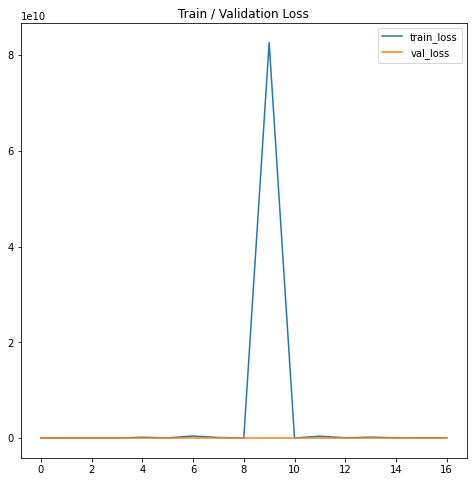

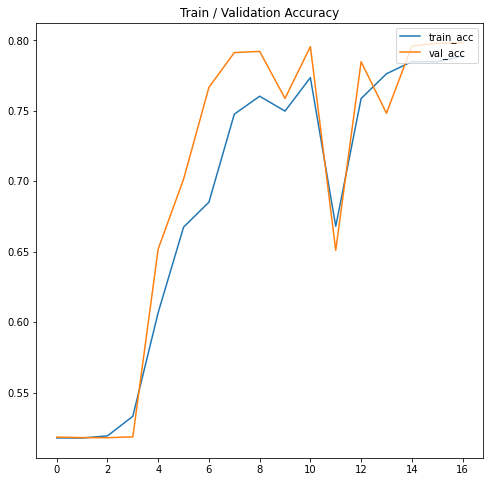

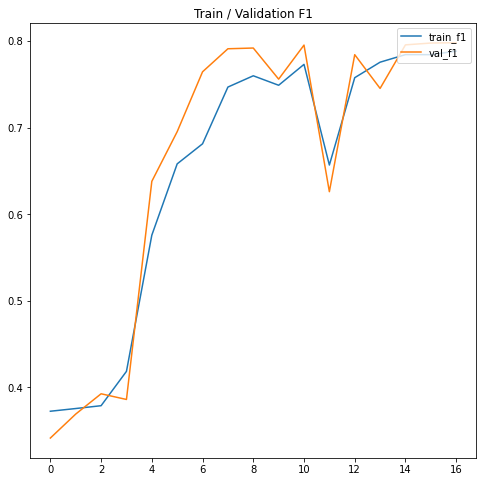

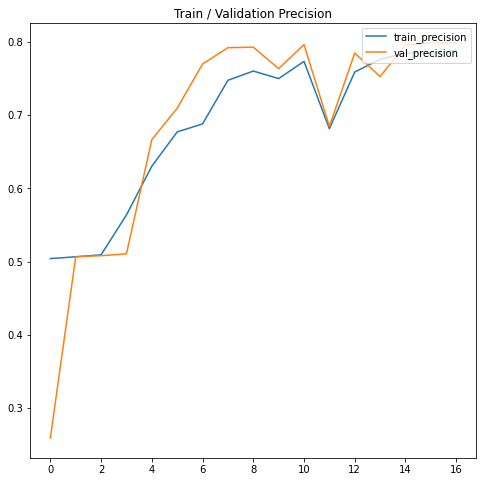

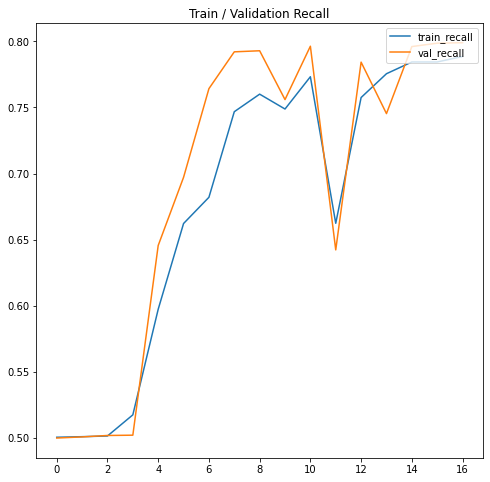

In [50]:
plot_results(log, history, plot_name='conv_history')

In [51]:
save_model(conv_model, config, model_name)

'models/default/conv-crypto-trading-distilbert-base-cased-1.bin'

# Evaluate

In [57]:
test_dataset = test_dataset.rename_column('target', 'label')

In [58]:
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=config['batch_size'])

### FFWD Model

In [91]:
model_name = 'ffwd-crypto-trading-distilbert-base-cased-1.bin'

In [92]:
ffwd_model = FeedforwardCryptoNN(base_model, input_dim=768 + 32, hidden_dim=256, output_dim=3, dropout=0.1, l1=0, l2=1.0, l3=0).to(device)
ffwd_model

FeedforwardCryptoNN(
  (base_model): DistilBertModel(
    (embeddings): Embeddings(
      (word_embeddings): Embedding(28996, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (transformer): Transformer(
      (layer): ModuleList(
        (0-5): 6 x TransformerBlock(
          (attention): MultiHeadSelfAttention(
            (dropout): Dropout(p=0.1, inplace=False)
            (q_lin): Linear(in_features=768, out_features=768, bias=True)
            (k_lin): Linear(in_features=768, out_features=768, bias=True)
            (v_lin): Linear(in_features=768, out_features=768, bias=True)
            (out_lin): Linear(in_features=768, out_features=768, bias=True)
          )
          (sa_layer_norm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
          (ffn): FFN(
            (dropout): Dropout(p=0.1, inplace=False)
            (lin1

In [93]:
state_dict = torch.load(model_path)

In [59]:
test_loss, test_preds, test_labels = eval_epoch(ffwd_model, test_dataloader, config)

100%|███████████████████████████████████████████| 98/98 [00:13<00:00,  7.05it/s]


#### Next token classification

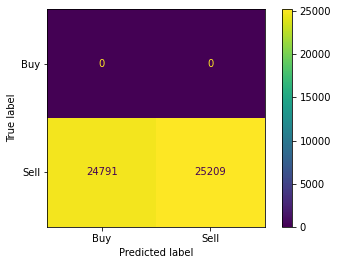

In [66]:
cm = confusion_matrix(test_preds[0, :], test_labels[0, :])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Buy', 'Sell'])
disp.plot()

#### Price regression

In [86]:
def normalize(v):
    return v / np.sqrt(np.sum(v**2))

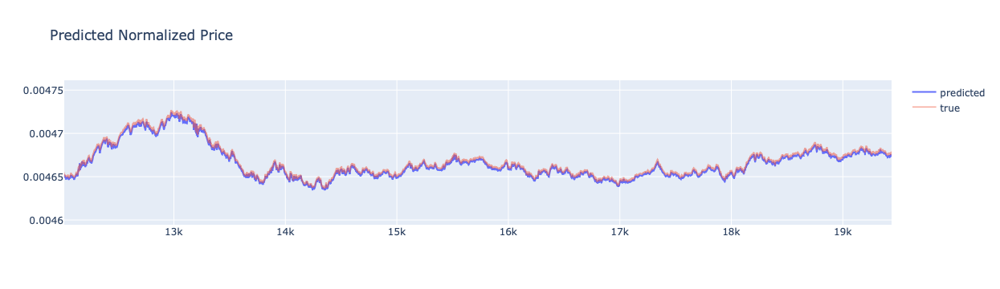

In [89]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=np.arange(len(test_preds[1, :])), y=normalize(np.array(test_preds[1, :])),
                    mode='lines',
                    name='predicted'))
fig.add_trace(go.Scatter(x=np.arange(len(test_labels[1, :])), y=normalize(np.array(test_labels[1, :])),
                    opacity=0.5,
                    mode='lines',
                    name='true'))

fig.update_layout(
    title='Predicted Normalized Price',
)


fig.show()

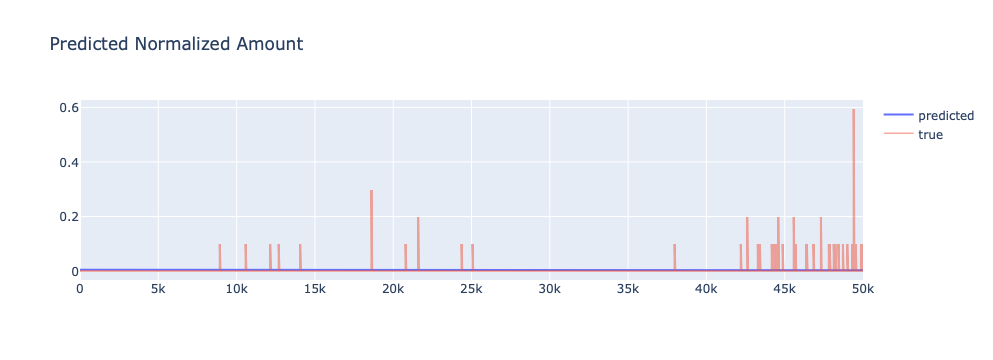

In [90]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=np.arange(len(test_preds[2, :])), y=normalize(np.array(test_preds[2, :])),
                    mode='lines',
                    name='predicted'))
fig.add_trace(go.Scatter(x=np.arange(len(test_labels[2, :])), y=normalize(np.array(test_labels[2, :])),
                    opacity=0.5,
                    mode='lines',
                    name='true'))

fig.update_layout(
    title='Predicted Normalized Amount',
)


fig.show()

### Conv Financial U-Net Model 

In [94]:
model_name = 'conv-crypto-trading-distilbert-base-cased-1.bin'

In [95]:
state_dict = torch.load(f'models/default/{model_name}')

In [96]:
conv_model = ConvCryptoNN(base_model, input_dim=768 + 32, hidden_dim=512, output_dim=3, dropout=0.1, l1=0, l2=0, l3=0).to(device)
conv_model

ConvCryptoNN(
  (base_model): DistilBertModel(
    (embeddings): Embeddings(
      (word_embeddings): Embedding(28996, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (transformer): Transformer(
      (layer): ModuleList(
        (0-5): 6 x TransformerBlock(
          (attention): MultiHeadSelfAttention(
            (dropout): Dropout(p=0.1, inplace=False)
            (q_lin): Linear(in_features=768, out_features=768, bias=True)
            (k_lin): Linear(in_features=768, out_features=768, bias=True)
            (v_lin): Linear(in_features=768, out_features=768, bias=True)
            (out_lin): Linear(in_features=768, out_features=768, bias=True)
          )
          (sa_layer_norm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
          (ffn): FFN(
            (dropout): Dropout(p=0.1, inplace=False)
            (lin1): Line

In [97]:
conv_model.load_state_dict(state_dict)

<All keys matched successfully>

In [98]:
test_loss, test_preds, test_labels = eval_epoch(conv_model, test_dataloader, config)

100%|███████████████████████████████████████████| 98/98 [00:14<00:00,  6.61it/s]


#### Next token classification

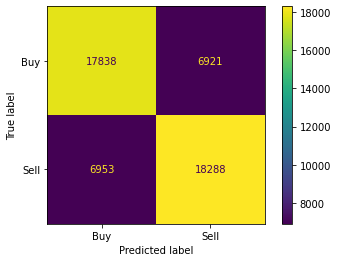

In [99]:
cm = confusion_matrix(test_preds[0, :], test_labels[0, :])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Buy', 'Sell'])
disp.plot()

#### Price regression

In [100]:
def normalize(v):
    return v / np.sqrt(np.sum(v**2))

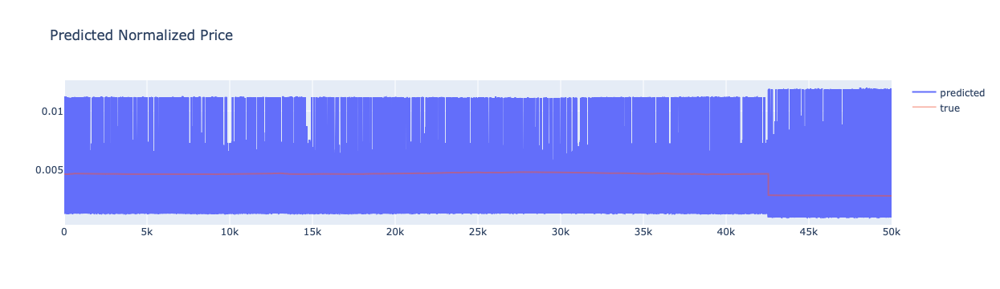

In [101]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=np.arange(len(test_preds[1, :])), y=normalize(np.array(test_preds[1, :])),
                    mode='lines',
                    name='predicted'))
fig.add_trace(go.Scatter(x=np.arange(len(test_labels[1, :])), y=normalize(np.array(test_labels[1, :])),
                    opacity=0.5,
                    mode='lines',
                    name='true'))

fig.update_layout(
    title='Predicted Normalized Price',
)


fig.show()

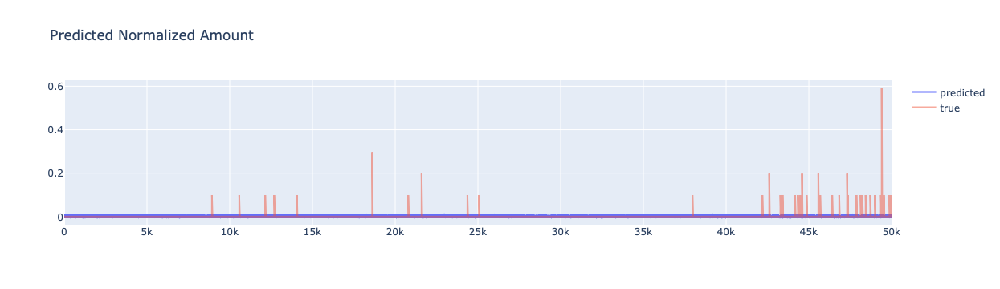

In [102]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=np.arange(len(test_preds[2, :])), y=normalize(np.array(test_preds[2, :])),
                    mode='lines',
                    name='predicted'))
fig.add_trace(go.Scatter(x=np.arange(len(test_labels[2, :])), y=normalize(np.array(test_labels[2, :])),
                    opacity=0.5,
                    mode='lines',
                    name='true'))

fig.update_layout(
    title='Predicted Normalized Amount',
)


fig.show()